In [1]:
import sys
import os

# Get the parent directory of the current notebook
module_path = os.path.abspath(os.path.join('..'))

# Add the model directory to the Python path
if module_path not in sys.path:
    sys.path.append(module_path)

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from ELM import ELM
from ModelWrapper import ModelWrapper

In [3]:
import mlflow
from mlflow.models import infer_signature

In [4]:
mlflow.set_tracking_uri("http://localhost:5000")
# Create a new MLflow Experiment
mlflow.set_experiment("four_tanks")

<Experiment: artifact_location='mlflow-artifacts:/359011060573495938', creation_time=1728287877007, experiment_id='359011060573495938', last_update_time=1728287877007, lifecycle_stage='active', name='four_tanks', tags={}>

In [5]:
pd.set_option('display.max_colwidth', None)

# Przygotowanie danych

In [6]:
data_path = "../../data/4_tanks/data/"

In [7]:
# dane bez zakłóceń
df_train = pd.read_csv(data_path+"result_ol_without_noise_uczące_v3.csv", sep=';', index_col=0)
df_val = pd.read_csv(data_path+"result_ol_without_noise_walidacyjne_v3.csv", sep=';', index_col=0)
df_test = pd.read_csv(data_path+"result_ol_without_noise_testowe_v3.csv", sep=';', index_col=0)
dataset_name = "bez zakłóceń"

In [8]:
# # dane z zakłóceniami
# df_train = pd.read_csv(data_path+"result_ol_with_noise_uczące_v3.csv", sep=';', index_col=0)
# df_val = pd.read_csv(data_path+"result_ol_with_noise_walidacyjne_v3.csv", sep=';', index_col=0)
# df_test = pd.read_csv(data_path+"result_ol_with_noise_testowe_v3.csv", sep=';', index_col=0)
# dataset_name = "z zakłóceniami"

In [ ]:
df_train.head()

,q_A [cm^3/s],q_B [cm^3/s],q_d1 [cm^3/s],q_d2 [cm^3/s],q_d3 [cm^3/s],q_d4 [cm^3/s],x1 [cm],x2 [cm],x3 [cm],x4 [cm]
0,452.78,555.56,0.0,0.0,0.0,0.0,65.000000,66.000000,65.000000,66.000000
1,452.78,555.56,0.0,0.0,-0.0,0.0,64.984326,65.937304,65.038198,65.992639
2,452.78,555.56,0.0,-0.0,0.0,-0.0,64.971213,65.878615,65.074774,65.985573
3,452.78,555.56,0.0,0.0,-0.0,-0.0,64.960438,65.823672,65.109799,65.978790
4,452.78,555.56,0.0,-0.0,0.0,-0.0,64.951795,65.772231,65.143339,65.972278


In [10]:
def transform_column_name(df):
    df.columns = [col[0] for col in df.columns.str.split()]
    return df

In [11]:
df_train = transform_column_name(df_train)
df_val = transform_column_name(df_val)
df_test = transform_column_name(df_test)

In [12]:
qa_max = round(3260000/3600, 2)
qa_min=0
qb_max = round(4000000/3600)
qb_min=0
x_max = 136
x_min = 20

In [13]:
def min_max_scale(s, min_value, max_value):
    return (s-min_value)/(max_value - min_value)

In [14]:
def min_max_scale_df(df):
    df['q_A'] = min_max_scale(df['q_A'], qa_min, qa_max)
    df['q_B'] = min_max_scale(df['q_B'], qb_min, qb_max)
    df['x1'] = min_max_scale(df['x1'], x_min, x_max)
    df['x2'] = min_max_scale(df['x2'], x_min, x_max)
    df['x3'] = min_max_scale(df['x3'], x_min, x_max)
    df['x4'] = min_max_scale(df['x4'], x_min, x_max)
    return df

In [15]:
df_train = min_max_scale_df(df_train)
df_val = min_max_scale_df(df_val)
df_test = min_max_scale_df(df_test)

In [16]:
def add_delay(df, col, steps=1):    
    df[col+f'(k-{steps})'] = df[col].shift(steps)
    return df

In [17]:
cols_delay = ['q_A', 'q_B', 'x1', 'x2', 'x3', 'x4']
for col in cols_delay:
    df_train = add_delay(df_train, col, 1)
    df_val = add_delay(df_val, col, 1)
    df_test = add_delay(df_test, col, 1)
    df_train = add_delay(df_train, col, 2)
    df_val = add_delay(df_val, col, 2)
    df_test = add_delay(df_test, col, 2)
    df_train = add_delay(df_train, col, 3)
    df_val = add_delay(df_val, col, 3)
    df_test = add_delay(df_test, col, 3)
    df_train = add_delay(df_train, col, 4)
    df_val = add_delay(df_val, col, 4)
    df_test = add_delay(df_test, col, 4)

In [18]:
df_train.dropna(inplace=True)
df_val.dropna(inplace=True)
df_test.dropna(inplace=True)

In [19]:
print(f"Wymiar danych uczących: {df_train.shape}")
print(f"Wymiar danych walidacyjnych: {df_val.shape}")
print(f"Wymiar danych testowych: {df_test.shape}")

Wymiar danych uczących: (2996, 34)
Wymiar danych walidacyjnych: (996, 34)
Wymiar danych testowych: (996, 34)


# ELM

In [20]:
model_class = "ELM"

In [21]:
y_names = ['x1', 'x2', 'x3', 'x4']

In [22]:
model_type_dict = {'statespace': 'w przestrzeni stanu', 'io': 'wejście-wyjście'}

In [34]:
pred_recursion = False
pred_mode = 'bez rekurencji'
# pred_recursion = True
# pred_mode = 'z rekurencją'

In [24]:
def calc_RMSE(df_train, df_val, df_test, y_name, y_pred_name):
    RMSE_train = round(metrics.root_mean_squared_error(df_train[y_name], df_train[y_pred_name]), 4)
    RMSE_val = round(metrics.root_mean_squared_error(df_val[y_name], df_val[y_pred_name]), 4)
    RMSE_test = round(metrics.root_mean_squared_error(df_test[y_name], df_test[y_pred_name]), 4)

    return RMSE_train, RMSE_val, RMSE_test

In [25]:
def predict_recursion(df, model, features, y_name, order_dyn):
    y_pred_list = np.empty(len(df))
    start_idx = 0
    if order_dyn == 1:
        y_pred_list[0] = df[y_name].iloc[0]
        start_idx = 1
    elif order_dyn==2:
        y_pred_list[0] = df[y_name].iloc[0]
        y_pred_list[1] = df[y_name].iloc[1]
        start_idx = 2
    elif order_dyn==3:
        y_pred_list[0] = df[y_name].iloc[0]
        y_pred_list[1] = df[y_name].iloc[1]
        y_pred_list[2] = df[y_name].iloc[2]
        start_idx = 3
    elif order_dyn==4:
        y_pred_list[0] = df[y_name].iloc[0]
        y_pred_list[1] = df[y_name].iloc[1]
        y_pred_list[2] = df[y_name].iloc[2]
        y_pred_list[3] = df[y_name].iloc[3]
        start_idx = 4
    for i in range(start_idx, len(df)):
        features_val = df[features].iloc[i].copy()
        # print(f'features_val:\n{features_val}')
        if order_dyn == 1:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
        if order_dyn == 2:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
            features_val[f'{y_name}(k-2)'] = y_pred_list[i-2]
        if order_dyn == 3:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
            features_val[f'{y_name}(k-2)'] = y_pred_list[i-2]
            features_val[f'{y_name}(k-3)'] = y_pred_list[i-3]
        if order_dyn == 4:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
            features_val[f'{y_name}(k-2)'] = y_pred_list[i-2]
            features_val[f'{y_name}(k-3)'] = y_pred_list[i-3]
            features_val[f'{y_name}(k-4)'] = y_pred_list[i-4]
        # print(f'features_val:\n{features_val}')
        y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
        # print(f'y_pred: {y_pred_list[i]}')
    return y_pred_list

In [42]:
def train_predict_lin_model(df_train, df_val, df_test, y_names, features_list, model_type, order_dyn, n_hidden_neurons, pred_recursion=False):
    
    models_results_df = pd.DataFrame(columns=["Typ modelu", "Zmienne wejściowe", "Zmienna wyjściowa", "RMSE_ucz", "RMSE_wal", "RMSE_test"])

    for y_name, features in zip(y_names, features_list):

        n_features = len(features)
        params = {"model_class": model_class, "model_type": model_type_dict[model_type], "order_dyn": order_dyn, "y_name": y_name+'(k)', "features": features, "n_hidden_neurons": n_hidden_neurons, "pred_recursion": pred_recursion}
        model = ELM(n_features, n_hidden_neurons)
        model.fit(df_train[features], df_train[y_name])

        # if pred_recursion:
        df_train[f'{y_name}_{model_type}_{order_dyn}_pred'] = predict_recursion(df_train, model, features, y_name, order_dyn)
        df_val[f'{y_name}_{model_type}_{order_dyn}_pred'] = predict_recursion(df_val, model, features, y_name, order_dyn)
        df_test[f'{y_name}_{model_type}_{order_dyn}_pred'] = predict_recursion(df_test, model, features, y_name, order_dyn)
        # else:
        df_train[f'{y_name}_{model_type}_{order_dyn}_pred'] = model.predict(df_train[features])
        df_val[f'{y_name}_{model_type}_{order_dyn}_pred'] = model.predict(df_val[features])
        df_test[f'{y_name}_{model_type}_{order_dyn}_pred'] = model.predict(df_test[features])
        
        df_train[f'e_{y_name}_{model_type}_{order_dyn}'] = df_train[y_name] - df_train[f'{y_name}_{model_type}_{order_dyn}_pred']
        df_val[f'e_{y_name}_{model_type}_{order_dyn}'] = df_val[y_name] - df_val[f'{y_name}_{model_type}_{order_dyn}_pred']
        df_test[f'e_{y_name}_{model_type}_{order_dyn}'] = df_test[y_name] - df_test[f'{y_name}_{model_type}_{order_dyn}_pred']
        RMSE_train, RMSE_val, RMSE_test = calc_RMSE(df_train, df_val, df_test, y_name, f'{y_name}_{model_type}_{order_dyn}_pred')
        metrics = {"RMSE_train": RMSE_train, "RMSE_val": RMSE_val, "RMSE_test": RMSE_test}
        
        # with mlflow.start_run():
        #     mlflow.log_params(params)
        #     mlflow.log_metrics(metrics)

        #     # Infer the model signature
        #     signature = infer_signature(df_train[features], df_train[f'{y_name}_{model_type}_{order_dyn}_pred'])
        #     # Log the model
        #     model_info = mlflow.pyfunc.log_model(
        #         python_model=ModelWrapper(model),
        #         artifact_path="model_elm",
        #         signature=signature,
        #         input_example=df_train[features],
        #         registered_model_name=f"{model_class}_{model_type}_{order_dyn}_{y_name}",
        #     )

    return df_train, df_val, df_test

In [43]:
n_hidden_neurons = 10

In [44]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)', 'x1(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x3(k-1)', 'x4(k-1)', 'x2(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x4(k-1)', 'x3(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)']]
model_type = 'statespace'
order_dyn = 1
df_train, df_val, df_test = train_predict_lin_model(df_train, df_val, df_test, y_names, features_list, model_type, order_dyn, n_hidden_neurons, pred_recursion)

ValueError: setting an array element with a sequence.

In [40]:
logged_model = 'runs:/b29d4d56032f49cb96d74094617425ac/model_elm'

# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)

In [70]:
loaded_model

mlflow.pyfunc.loaded_model:
  artifact_path: model_elm
  flavor: mlflow.pyfunc.model
  run_id: b29d4d56032f49cb96d74094617425ac

In [50]:
loaded_model.model_config

{}

In [53]:
loaded_model.params_schema

In [69]:
loaded_model.unwrap_python_model().model.num_hidden_neurons

10

In [59]:
features = ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)']
y_name = 'x4'

In [60]:
n_features = len(features)
params = {"model_class": model_class, "model_type": model_type_dict[model_type], "order_dyn": order_dyn, "y_name": y_name+'(k)', "features": features, "n_hidden_neurons": n_hidden_neurons, "pred_recursion": pred_recursion}
model = ELM(n_features, n_hidden_neurons)
model.fit(df_train[features], df_train[y_name])

In [61]:
wrapper = ModelWrapper(model)

In [45]:
y_pred_val = loaded_model.predict(pd.DataFrame(df_val[['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)', 'x1(k-1)']]))
metrics.root_mean_squared_error(y_pred=y_pred_val, y_true=df_val['x4'])

0.16303674853512476

In [46]:
y_pred_train = loaded_model.predict(pd.DataFrame(df_train[['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)', 'x1(k-1)']]))
metrics.root_mean_squared_error(y_pred=y_pred_train, y_true=df_train['x4'])

0.061611872351172506

In [118]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)']]
model_type = 'io'
order_dyn = 1
df_train, df_val, df_test, = train_predict_lin_model(df_train, df_val, df_test, y_names, features_list, model_type, order_dyn, n_hidden_neurons, pred_recursion)

C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future

In [119]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)']]
model_type = 'io'
order_dyn = 2
df_train, df_val, df_test = train_predict_lin_model(df_train, df_val, df_test, y_names, features_list, model_type, order_dyn, n_hidden_neurons, pred_recursion)

C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future

In [120]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)']]
model_type = 'io'
order_dyn = 3
df_train, df_val, df_test = train_predict_lin_model(df_train, df_val, df_test, y_names, features_list, model_type, order_dyn, n_hidden_neurons, pred_recursion)

C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14748\2579815219.py:40: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future

In [262]:
# features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x1(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x2(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x3(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x4(k-4)']]
# model_type = 'io'
# order_dyn = 4
# df_train, df_val, df_test = train_predict_lin_model(df_train, df_val, df_test, y_names, features_list, model_type, order_dyn, n_hidden_neurons, pred_recursion)

C:\Users\zgore\AppData\Local\Temp\ipykernel_8416\2579815219.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_8416\2579815219.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_8416\2579815219.py:40: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_l

In [92]:
def get_result_per_output(y_name, models_results_df):
    models_results_df1 = models_results_df[models_results_df["Zmienna wyjściowa"]==f'{y_name}(k)']
    models_results_df1.index = np.arange(1, len(models_results_df1)+1)
    return models_results_df1

In [93]:
models_results_df.rename(columns={'RMSE_ucz': '$RMSE_{ucz}$', 'RMSE_wal': '$RMSE_{wal}$', 'RMSE_test': '$RMSE_{test}$'}, inplace=True)

In [94]:
models_results_df_x1 = get_result_per_output('x1', models_results_df)
models_results_df_x2 = get_result_per_output('x2', models_results_df)
models_results_df_x3 = get_result_per_output('x3', models_results_df)
models_results_df_x4 = get_result_per_output('x4', models_results_df)

In [97]:
models_results_df_x1[['Typ modelu', 'Zmienne wejściowe', 'Zmienna wyjściowa', 
       '$RMSE_{ucz}$', '$RMSE_{wal}$', '$RMSE_{test}$']]

,Typ modelu,Zmienne wejściowe,Zmienna wyjściowa,$RMSE_{ucz}$,$RMSE_{wal}$,$RMSE_{test}$
1,w przestrzeni stanu,"[q_A(k-1), q_B(k-1), x2(k-1), x3(k-1), x4(k-1), x1(k-1)]",x1(k),0.0,0.0244,0.0022


In [267]:
models_results_df_x1[['Typ modelu', 'Zmienne wejściowe', 'Zmienna wyjściowa', 
       '$RMSE_{ucz}$', '$RMSE_{wal}$', '$RMSE_{test}$']]

,Typ modelu,Zmienne wejściowe,Zmienna wyjściowa,$RMSE_{ucz}$,$RMSE_{ucz}$,$RMSE_{wal}$,$RMSE_{wal}$,$RMSE_{test}$,$RMSE_{test}$
1,w przestrzeni stanu,"[q_A(k-1), q_B(k-1), x2(k-1), x3(k-1), x4(k-1), x1(k-1)]",x1(k),4.3289,NaN,5.6589,NaN,2.8588,NaN
2,wejście-wyjście,"[q_A(k-1), q_B(k-1), x1(k-1)]",x1(k),7.9824,NaN,13.6190,NaN,4.1088,NaN
3,wejście-wyjście,"[q_A(k-1), q_B(k-1), x1(k-1), q_A(k-2), q_B(k-2), x1(k-2)]",x1(k),7.8092,NaN,11.2802,NaN,4.6640,NaN
4,wejście-wyjście,"[q_A(k-1), q_B(k-1), x1(k-1), q_A(k-2), q_B(k-2), x1(k-2), q_A(k-3), q_B(k-3), x1(k-3)]",x1(k),8.1947,NaN,10.7844,NaN,5.1746,NaN
5,wejście-wyjście,"[q_A(k-1), q_B(k-1), x1(k-1), q_A(k-2), q_B(k-2), x1(k-2), q_A(k-3), q_B(k-3), x1(k-3), q_A(k-4), q_B(k-4), x1(k-4)]",x1(k),52.5331,NaN,17.7031,NaN,15.7207,NaN
6,wejście-wyjście,"[q_A(k-1), q_B(k-1), x1(k-1), q_A(k-2), q_B(k-2), x1(k-2), q_A(k-3), q_B(k-3), x1(k-3), q_A(k-4), q_B(k-4), x1(k-4)]",x1(k),NaN,7.9123,NaN,10.5467,NaN,4.9765


In [268]:
print(models_results_df_x1[['Typ modelu', 'Zmienne wejściowe', 'Zmienna wyjściowa', 
       '$RMSE_{ucz}$', '$RMSE_{wal}$', '$RMSE_{test}$']].to_latex(float_format="%.4f", caption=f'Wyniki modelowania poziomu w 1. zbiorniku {pred_mode} dla {model_class} dla danych {dataset_name}.', label=f'tab:res_{model_class}_{dataset_name}_{pred_mode}_x1'))

\begin{table}
\caption{Wyniki modelowania poziomu w 1. zbiorniku z rekurencją dla regresji liniowej dla danych bez zakłóceń.}
\label{tab:res_regresji liniowej_bez zakłóceń_z rekurencją_x1}
\begin{tabular}{llllrrrrrr}
\toprule
 & Typ modelu & Zmienne wejściowe & Zmienna wyjściowa & $RMSE_{ucz}$ & $RMSE_{ucz}$ & $RMSE_{wal}$ & $RMSE_{wal}$ & $RMSE_{test}$ & $RMSE_{test}$ \\
\midrule
1 & w przestrzeni stanu & ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)', 'x1(k-1)'] & x1(k) & 4.3289 & NaN & 5.6589 & NaN & 2.8588 & NaN \\
2 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)'] & x1(k) & 7.9824 & NaN & 13.6190 & NaN & 4.1088 & NaN \\
3 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)'] & x1(k) & 7.8092 & NaN & 11.2802 & NaN & 4.6640 & NaN \\
4 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)'] & x1(k) & 8.1947 & NaN & 10.7844 & NaN & 5.1746 & NaN \\
5 & wejście-wyj

In [269]:
print(models_results_df_x2[['Typ modelu', 'Zmienne wejściowe', 'Zmienna wyjściowa', 
       '$RMSE_{ucz}$', '$RMSE_{wal}$', '$RMSE_{test}$']].to_latex(float_format="%.4f", caption=f'Wyniki modelowania poziomu w 2. zbiorniku {pred_mode} dla {model_class} dla danych {dataset_name}.', label=f'tab:res_{model_class}_{dataset_name}_{pred_mode}_x2'))

\begin{table}
\caption{Wyniki modelowania poziomu w 2. zbiorniku z rekurencją dla regresji liniowej dla danych bez zakłóceń.}
\label{tab:res_regresji liniowej_bez zakłóceń_z rekurencją_x2}
\begin{tabular}{llllrrrrrr}
\toprule
 & Typ modelu & Zmienne wejściowe & Zmienna wyjściowa & $RMSE_{ucz}$ & $RMSE_{ucz}$ & $RMSE_{wal}$ & $RMSE_{wal}$ & $RMSE_{test}$ & $RMSE_{test}$ \\
\midrule
1 & w przestrzeni stanu & ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x3(k-1)', 'x4(k-1)', 'x2(k-1)'] & x2(k) & 3.8011 & NaN & 9.8046 & NaN & 3.4128 & NaN \\
2 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)'] & x2(k) & 9.0713 & NaN & 10.4254 & NaN & 5.9513 & NaN \\
3 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)'] & x2(k) & 7.1892 & NaN & 7.5628 & NaN & 6.3559 & NaN \\
4 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)'] & x2(k) & 7.7763 & NaN & 8.1669 & NaN & 6.2274 & NaN \\
5 & wejście-wyjśc

In [270]:
print(models_results_df_x3[['Typ modelu', 'Zmienne wejściowe', 'Zmienna wyjściowa', 
       '$RMSE_{ucz}$', '$RMSE_{wal}$', '$RMSE_{test}$']].to_latex(float_format="%.4f", caption=f'Wyniki modelowania poziomu w 3. zbiorniku {pred_mode} dla {model_class} dla danych {dataset_name}.', label=f'tab:res_{model_class}_{dataset_name}_{pred_mode}_x3'))

\begin{table}
\caption{Wyniki modelowania poziomu w 3. zbiorniku z rekurencją dla regresji liniowej dla danych bez zakłóceń.}
\label{tab:res_regresji liniowej_bez zakłóceń_z rekurencją_x3}
\begin{tabular}{llllrrrrrr}
\toprule
 & Typ modelu & Zmienne wejściowe & Zmienna wyjściowa & $RMSE_{ucz}$ & $RMSE_{ucz}$ & $RMSE_{wal}$ & $RMSE_{wal}$ & $RMSE_{test}$ & $RMSE_{test}$ \\
\midrule
1 & w przestrzeni stanu & ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x4(k-1)', 'x3(k-1)'] & x3(k) & 61229932944113.9219 & NaN & 17413.3070 & NaN & 45706.8645 & NaN \\
2 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)'] & x3(k) & 19.3395 & NaN & 22.6116 & NaN & 8.6742 & NaN \\
3 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)'] & x3(k) & 61.4304 & NaN & 17.5903 & NaN & 13.9503 & NaN \\
4 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)'] & x3(k) & 42.2878 & NaN & 17.2699 & NaN & 5.8835

In [271]:
print(models_results_df_x4[['Typ modelu', 'Zmienne wejściowe', 'Zmienna wyjściowa', 
       '$RMSE_{ucz}$', '$RMSE_{wal}$', '$RMSE_{test}$']].to_latex(float_format="%.4f", caption=f'Wyniki modelowania poziomu w 4. zbiorniku {pred_mode} dla {model_class} dla danych {dataset_name}.', label=f'tab:res_{model_class}_{dataset_name}_{pred_mode}_x4'))

\begin{table}
\caption{Wyniki modelowania poziomu w 4. zbiorniku z rekurencją dla regresji liniowej dla danych bez zakłóceń.}
\label{tab:res_regresji liniowej_bez zakłóceń_z rekurencją_x4}
\begin{tabular}{llllrrrrrr}
\toprule
 & Typ modelu & Zmienne wejściowe & Zmienna wyjściowa & $RMSE_{ucz}$ & $RMSE_{ucz}$ & $RMSE_{wal}$ & $RMSE_{wal}$ & $RMSE_{test}$ & $RMSE_{test}$ \\
\midrule
1 & w przestrzeni stanu & ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)'] & x4(k) & 38.4505 & NaN & 37.6340 & NaN & 68.5172 & NaN \\
2 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)'] & x4(k) & 14.8214 & NaN & 13.0762 & NaN & 14.5869 & NaN \\
3 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)'] & x4(k) & 17.1858 & NaN & 5.2980 & NaN & 7.2749 & NaN \\
4 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)'] & x4(k) & 15.0671 & NaN & 9.1100 & NaN & 11.9536 & NaN \\
5 & wejśc

In [272]:
print(models_results_df_x1[['Typ modelu', 'Zmienne wejściowe', 'Zmienna wyjściowa', 
       '$RMSE_{ucz}$', '$RMSE_{wal}$', '$RMSE_{test}$']].to_latex(float_format="%.4f", caption=f'Wyniki modelowania poziomu w 1. zbiorniku {pred_mode} dla {model_class} dla danych {dataset_name}.', label=f'tab:res_{model_class}_{dataset_name}_{pred_mode}_x1'))

\begin{table}
\caption{Wyniki modelowania poziomu w 1. zbiorniku z rekurencją dla regresji liniowej dla danych bez zakłóceń.}
\label{tab:res_regresji liniowej_bez zakłóceń_z rekurencją_x1}
\begin{tabular}{llllrrrrrr}
\toprule
 & Typ modelu & Zmienne wejściowe & Zmienna wyjściowa & $RMSE_{ucz}$ & $RMSE_{ucz}$ & $RMSE_{wal}$ & $RMSE_{wal}$ & $RMSE_{test}$ & $RMSE_{test}$ \\
\midrule
1 & w przestrzeni stanu & ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)', 'x1(k-1)'] & x1(k) & 4.3289 & NaN & 5.6589 & NaN & 2.8588 & NaN \\
2 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)'] & x1(k) & 7.9824 & NaN & 13.6190 & NaN & 4.1088 & NaN \\
3 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)'] & x1(k) & 7.8092 & NaN & 11.2802 & NaN & 4.6640 & NaN \\
4 & wejście-wyjście & ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)'] & x1(k) & 8.1947 & NaN & 10.7844 & NaN & 5.1746 & NaN \\
5 & wejście-wyj

In [273]:
# y_name_pred_split = y_name_pred.split('_')
# model_class = y_name_pred_split[1]
# order_dyn = y_name_pred_split[2]
# model_type_dict[model_class]

In [274]:
def plot_model_result(df, y_name):
    plt.grid()
    plt.plot(df[y_name], label=f'dane rzeczywiste')
    y_names_pred = [col for col in df.columns if (y_name in col) & ('pred' in col)]
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    color_i=0
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, y_name_pred in enumerate(y_names_pred):
        plt.plot(df[y_name_pred], label=f'wyjście modelu {i+1}', linestyle=line_styles[i % len(line_styles)], c=colors[i%len(colors)])
    plt.xlabel('k')
    plt.ylabel(f'$x_{y_name[1]} [cm]$')
    plt.title(f"Poziom cieczy w {y_name[1]}. zbiorniku")
    plt.legend()

In [275]:
def plot_model_result_without_h1(df, y_name):
    plt.grid()
    plt.plot(df[y_name], label=f'dane rzeczywiste')
    y_names_pred = [col for col in df.columns if (y_name in col) & ('pred' in col)]
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    color_i=0
    # if pred_mode=='z rekurencją':
    #     color_i=1
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, y_name_pred in enumerate(y_names_pred):
        i +=1
        plt.plot(df[y_name_pred], label=f'wyjście modelu {i+1}', linestyle=line_styles[i % len(line_styles)], c=colors[i%len(colors)])
    plt.xlabel('k')
    plt.ylabel(f'$x_{y_name[1]} [cm]$')
    plt.title(f"Poziom cieczy w {y_name[1]}. zbiorniku")
    plt.legend()

In [276]:
def plot_model_result_all_tanks(df, dataset_name, data_name, pred_mode):
    num_plots = 4
    if pred_mode=='z rekurencją':
        num_plots=5
    fig=plt.figure(figsize=(8,11.5))
    plt.subplot(num_plots, 1, 1)
    plot_model_result(df, 'x1')
    plt.subplot(num_plots, 1, 2)
    plot_model_result(df, 'x2')
    plt.subplot(num_plots, 1, 3)
    plot_model_result(df, 'x3')
    if pred_mode=='z rekurencją':
        plt.subplot(num_plots, 1, 4)
        df_to_plot = df.drop(columns=['x3_statespace_1_pred'])
        plot_model_result_without_h1(df_to_plot, 'x3')
    plt.subplot(num_plots, 1, num_plots)
    plot_model_result(df, 'x4')

    plt.subplots_adjust(hspace=0.4*num_plots/4)
    fig.subplots_adjust(top=0.92)
    fig.suptitle(f"Wyniki {pred_mode} modeli liniowych dla danych {data_name} {dataset_name}")

    plt.savefig(f"../img/result_ol_{model_class}_{data_name}_{dataset_name}_{pred_mode}.png", bbox_inches='tight')

    plt.show()

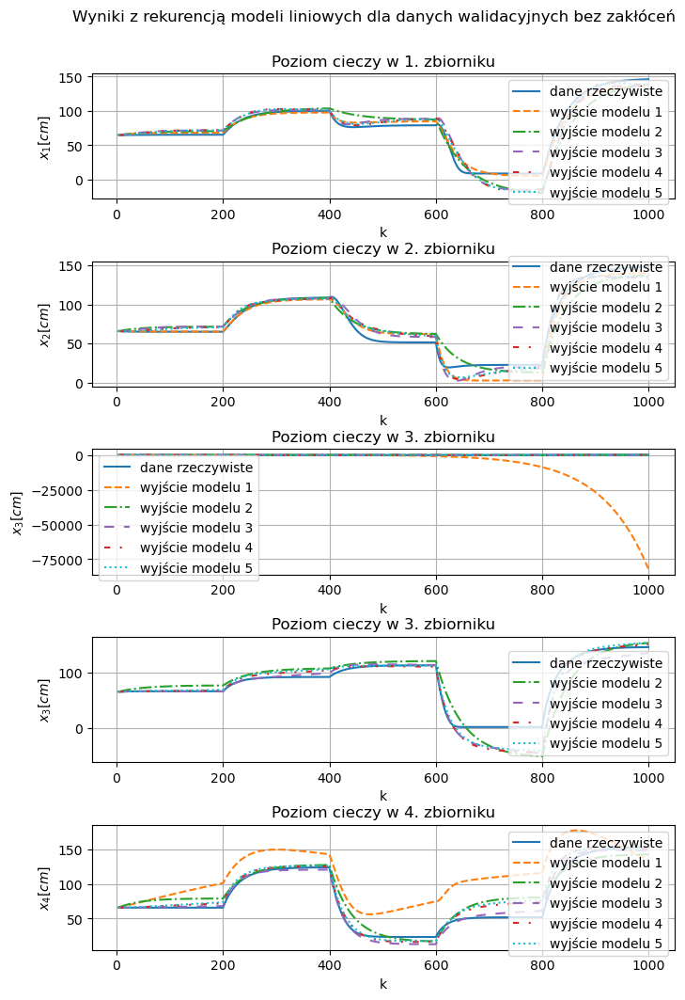

In [277]:
plot_model_result_all_tanks(df_val, dataset_name, "walidacyjnych", pred_mode)

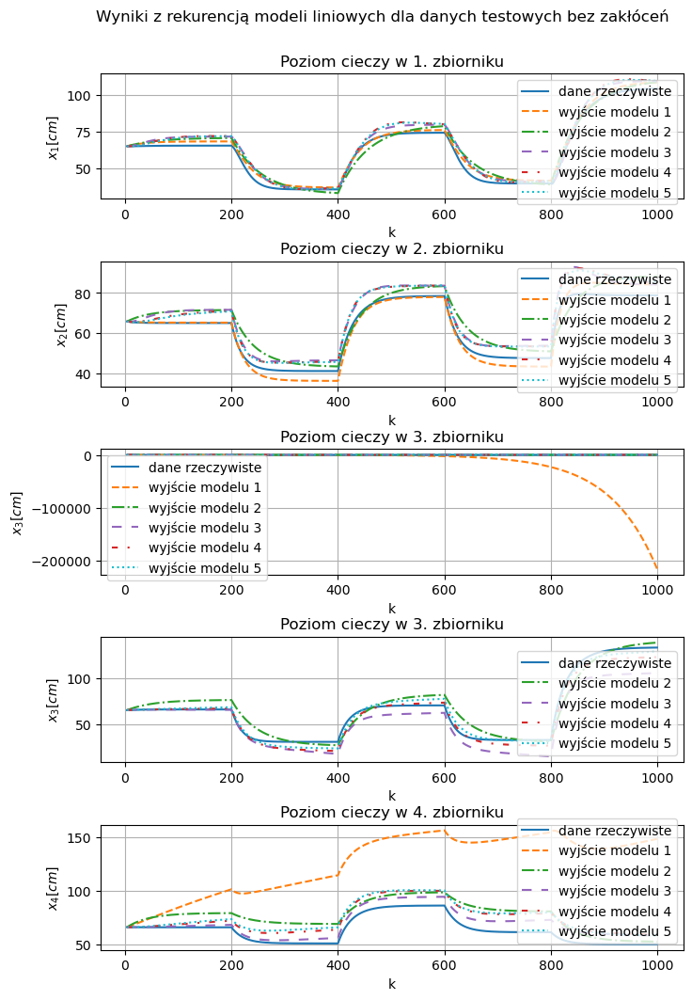

In [278]:
plot_model_result_all_tanks(df_test, dataset_name, "testowych", pred_mode)

In [279]:
def plot_model_error(df, y_name):
    plt.grid()
    e_list = [col for col in df.columns if (y_name in col) & ('e_x' in col)]
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    color_i=0
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, e in enumerate(e_list):
        plt.plot(df[e], label=f'błąd modelu {i+1}', c=colors[i%len(colors)], linestyle=line_styles[i % len(line_styles)])
    plt.xlabel('k')
    plt.ylabel(f'$e_{{x{y_name[1]}}}$')
    plt.title(f"Błędy modeli dla {y_name[1]}. zbiornika")
    plt.legend()

In [280]:
def plot_model_error_without_h1(df, y_name):
    plt.grid()
    e_list = [col for col in df.columns if (y_name in col) & ('e_x' in col)]
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, e in enumerate(e_list):
        i += 1
        plt.plot(df[e], label=f'błąd modelu {i+1}', c=colors[i%len(colors)], linestyle=line_styles[i % len(line_styles)])
    plt.xlabel('k')
    plt.ylabel(f'$e_{{x{y_name[1]}}}$')
    plt.title(f"Błędy modeli dla {y_name[1]}. zbiornika")
    plt.legend()

In [281]:
def plot_model_error_all_tanks(df, dataset_name, data_name, pred_mode):
    num_plots = 4
    if pred_mode=='z rekurencją':
        num_plots=5
    fig=plt.figure(figsize=(8,11.5))
    plt.subplot(num_plots, 1, 1)
    plot_model_error(df, 'x1')
    plt.subplot(num_plots, 1, 2)
    plot_model_error(df, 'x2')
    plt.subplot(num_plots, 1, 3)
    plot_model_error(df, 'x3')
    if pred_mode=='z rekurencją':
        plt.subplot(num_plots, 1, 4)
        df_to_plot = df.drop(columns=['e_x3_statespace_1'])
        plot_model_error_without_h1(df_to_plot, 'x3')
    plt.subplot(num_plots, 1, num_plots)
    plot_model_error(df, 'x4')

    plt.subplots_adjust(hspace=0.4*num_plots/4)
    fig.subplots_adjust(top=0.92)
    fig.suptitle(f"Błędy modeli liniowych dla danych {data_name} {dataset_name} w trybie {pred_mode}")

    plt.savefig(f"../img/error_ol_{model_class}_{data_name}_{dataset_name}_v3_{pred_mode}.png", bbox_inches='tight')

    plt.show()

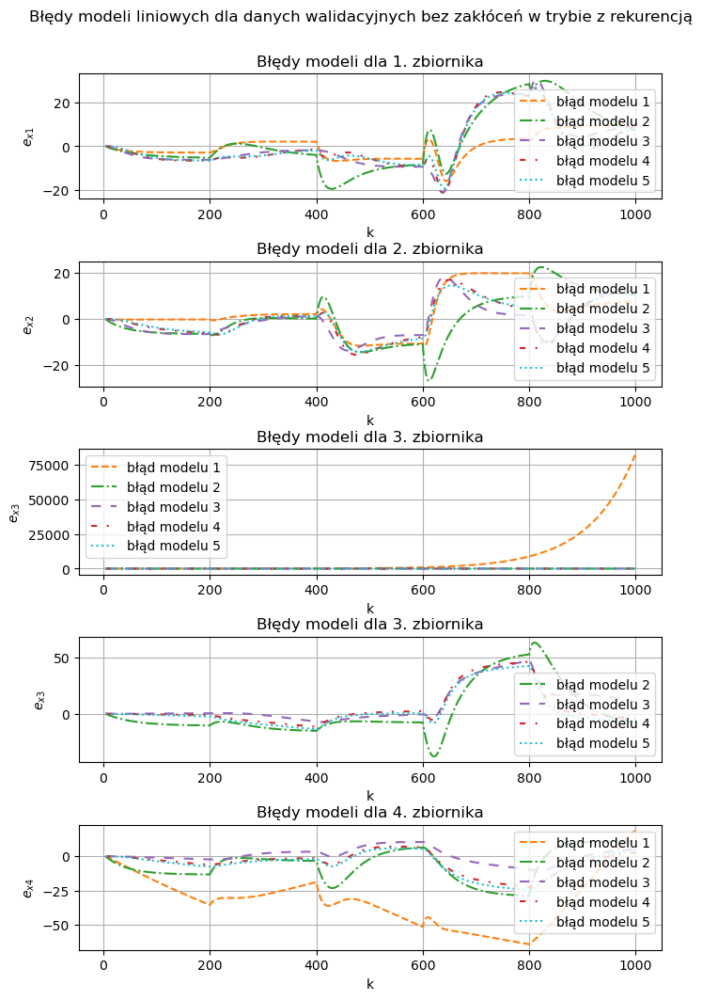

In [282]:
plot_model_error_all_tanks(df_val, dataset_name, "walidacyjnych", pred_mode)

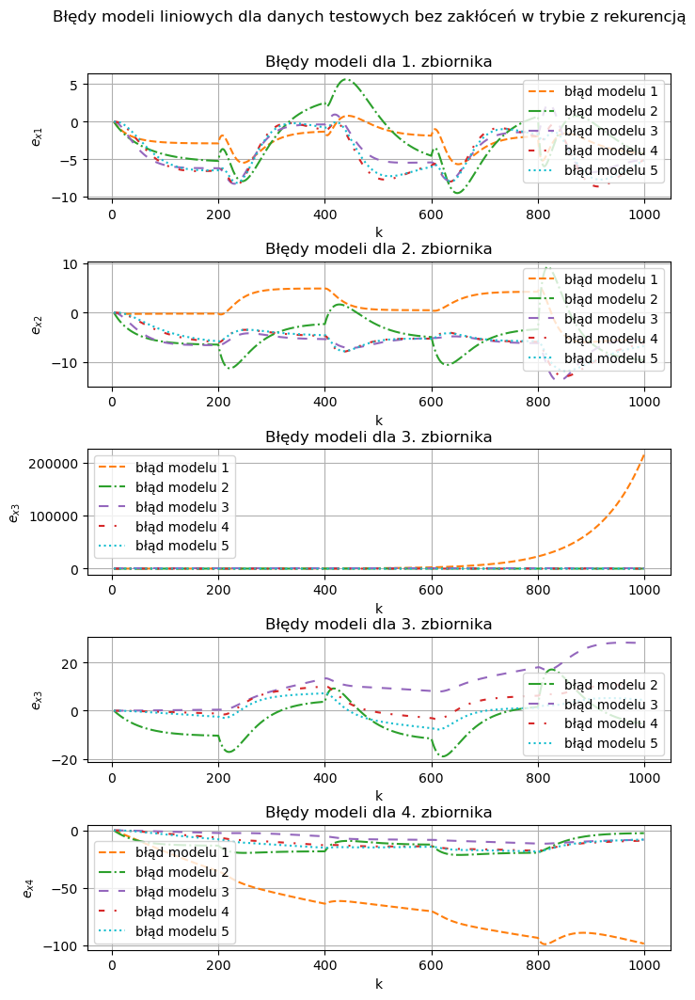

In [283]:
plot_model_error_all_tanks(df_test, dataset_name, "testowych", pred_mode)